# EDA Germany 

In [1]:
#Importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from datetime import date, time, datetime
from IPython import display
import os
import datetime

In [2]:
#Create dataframe from CSV
df = pd.read_csv("../data/fromAPI/cleaned_hourly_all.csv")
df2 = pd.read_csv("../data/fromAPI/cleaned_hourly_all2.csv")



In [3]:
df = pd.concat([df, df2])
del df2

date_format = "%Y-%m-%d %H:%M:%S"
df["arrival_plan"] = pd.to_datetime(df["arrival_plan"], format=date_format)
df["departure_plan"] = pd.to_datetime(df["departure_plan"], format=date_format)
df["arrival_change"] = pd.to_datetime(df["arrival_change"], format=date_format)
df["departure_change"] = pd.to_datetime(df["departure_change"], format=date_format)

df["arrival_plan_time"] = df["arrival_plan"].dt.time
df["arrival_plan_date"] = df["arrival_plan"].dt.date

df["departure_plan_time"] = df["departure_plan"].dt.time
df["departure_plan_date"] = df["departure_plan"].dt.date

df.drop(labels=["ID", "eva_nr", "zip"], axis=1, inplace=True)

In [4]:
df.head()

,ID,line,path,eva_nr,category,name,state,city,zip,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,arrival_delay_check,departure_delay_check,info
0,4083473720689476753-2406231250-4,20,Stolberg(Rheinl)Hbf|Eilendorf|Aachen-Rothe Erde,8000001,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,52064,6.091499,50.7678,2024-06-23 13:01:00,2024-06-23 13:02:00,2024-06-23 13:03:00,2024-06-23 13:04:00,2,2,on_time,on_time,NaN
1,-8892239479013746475-2406231212-14,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,8000001,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,52064,6.091499,50.7678,2024-06-23 13:00:00,2024-06-23 13:01:00,2024-06-23 13:05:00,2024-06-23 13:06:00,5,5,on_time,on_time,NaN
2,3772983581833112391-2406231337-1,33,NaN,8000001,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,52064,6.091499,50.7678,NaN,2024-06-23 13:37:00,NaN,NaN,0,0,on_time,on_time,NaN
3,-7760689325071259199-2406231337-1,29,NaN,8000001,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,52064,6.091499,50.7678,NaN,2024-06-23 13:37:00,NaN,NaN,0,0,on_time,on_time,NaN
4,3762663024269879642-2406231318-1,9,NaN,8000001,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,52064,6.091499,50.7678,NaN,2024-06-23 13:18:00,NaN,2024-06-23 13:18:00,0,0,on_time,on_time,NaN


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2186452 entries, 0 to 976275
Data columns (total 24 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   ID                     object        
 1   line                   object        
 2   path                   object        
 3   eva_nr                 int64         
 4   category               int64         
 5   name                   object        
 6   state                  object        
 7   city                   object        
 8   zip                    int64         
 9   long                   float64       
 10  lat                    float64       
 11  arrival_plan           datetime64[ns]
 12  departure_plan         datetime64[ns]
 13  arrival_change         datetime64[ns]
 14  departure_change       datetime64[ns]
 15  arrival_delay_m        int64         
 16  departure_delay_m      int64         
 17  arrival_delay_check    object        
 18  departure_delay_check  objec

In [8]:
df.describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m
count,2.186452e+06,2.186452e+06,2.186452e+06,1961604,2186452,1701925,1853529,2.186452e+06,2.186452e+06
mean,3.872590e+00,1.017290e+01,5.087546e+01,2024-06-29 20:35:35.781503488,2024-06-29 20:31:50.897225728,2024-06-29 21:52:47.235372544,2024-06-29 22:05:55.709297664,1.428960e+00,1.489471e+00
min,1.000000e+00,6.070715e+00,4.741103e+01,2024-06-23 12:46:00,2024-06-23 13:00:00,2024-06-23 12:46:00,2024-06-23 13:00:00,0.000000e+00,0.000000e+00
25%,3.000000e+00,8.490630e+00,4.934848e+01,2024-06-25 13:23:00,2024-06-25 13:21:00,2024-06-25 13:40:00,2024-06-25 13:44:00,0.000000e+00,0.000000e+00
50%,4.000000e+00,9.930920e+00,5.106590e+01,2024-06-27 08:39:00,2024-06-27 08:36:00,2024-06-27 09:21:00,2024-06-27 09:29:00,0.000000e+00,0.000000e+00
75%,5.000000e+00,1.208007e+01,5.247808e+01,2024-07-04 18:26:00,2024-07-04 18:26:00,2024-07-04 18:36:00,2024-07-04 18:37:00,1.000000e+00,1.000000e+00
max,5.000000e+00,1.497908e+01,5.490684e+01,2024-07-06 19:59:00,2024-07-06 20:18:00,2024-07-06 20:55:00,2024-07-06 20:56:00,3.920000e+02,3.960000e+02
std,1.035615e+00,2.273147e+00,1.789223e+00,NaN,NaN,NaN,NaN,4.054790e+00,4.091564e+00


In [9]:
df.head()

,line,path,category,name,state,city,long,lat,arrival_plan,departure_plan,...,departure_change,arrival_delay_m,departure_delay_m,arrival_delay_check,departure_delay_check,info,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date
0,20,Stolberg(Rheinl)Hbf|Eilendorf|Aachen-Rothe Erde,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.7678,2024-06-23 13:01:00,2024-06-23 13:02:00,...,2024-06-23 13:04:00,2,2,on_time,on_time,NaN,13:01:00,2024-06-23,13:02:00,2024-06-23
1,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.7678,2024-06-23 13:00:00,2024-06-23 13:01:00,...,2024-06-23 13:06:00,5,5,on_time,on_time,NaN,13:00:00,2024-06-23,13:01:00,2024-06-23
2,33,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.7678,NaT,2024-06-23 13:37:00,...,NaT,0,0,on_time,on_time,NaN,NaT,NaT,13:37:00,2024-06-23
3,29,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.7678,NaT,2024-06-23 13:37:00,...,NaT,0,0,on_time,on_time,NaN,NaT,NaT,13:37:00,2024-06-23
4,9,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.7678,NaT,2024-06-23 13:18:00,...,2024-06-23 13:18:00,0,0,on_time,on_time,NaN,NaT,NaT,13:18:00,2024-06-23


**Montag - Mittwoch**
24.06 00:00  - 26.06 23:00
**Donnerstag - Freitag**
4.07 00:00 - 05.07 - 23:00


creating a monday - friday timeline from the two datasets.<br>

In [10]:
## only used to with the combined data from the first two measurements!
dates_to_remove = [datetime.date(2024, 6, 23), datetime.date(2024, 6, 27),
                   datetime.date(2024, 7, 3), datetime.date(2024, 7, 6)]

date_replacements = {
    datetime.date(2024, 7, 4): datetime.date(2024, 6, 27),
    datetime.date(2024, 7, 5): datetime.date(2024, 6, 28)
}

def replace_date(dt, date_replacements):
    if pd.isnull(dt):
        return dt
    new_date = date_replacements.get(dt.date(), dt.date())
    return datetime.datetime.combine(new_date, dt.time())

df = df[~df['arrival_plan_date'].isin(dates_to_remove)].copy()
df = df[~df['departure_plan_date'].isin(dates_to_remove)].copy()

df['arrival_plan_date'] = df['arrival_plan_date'].replace(date_replacements)
df['departure_plan_date'] = df['departure_plan_date'].replace(date_replacements)

df['arrival_plan'] = df['arrival_plan'].apply(lambda x: replace_date(x, date_replacements))
df['departure_plan'] = df['departure_plan'].apply(lambda x: replace_date(x, date_replacements))

In [12]:
#exporting for TSA
#df.to_csv("../data/fromAPI/combined_data.csv", index=False)

# Temporal analysis

arranging the data and creating new features

In [15]:
df_temp_arr = df.dropna(subset=["arrival_plan"])
df_temp_dep = df.dropna(subset=["departure_plan"])

date_format = "%Y-%m-%d %H:%M:%S"
df_temp_arr = df.dropna(subset=["arrival_plan"]).copy()
df_temp_arr.loc[:, "arrival_plan_hour"] = df_temp_arr["arrival_plan"].dt.hour
df_temp_arr.loc[:, "arrival_plan_datetime"] = (
    df_temp_arr["arrival_plan_date"].astype(str) + ' ' +
    df_temp_arr["arrival_plan_hour"].astype(str) + ':00:00'
)
df_temp_arr.loc[:, "arrival_plan_datetime"] = pd.to_datetime(df_temp_arr["arrival_plan_datetime"], format=date_format)


df_temp_dep = df.dropna(subset=["departure_plan"]).copy()
df_temp_dep.loc[:, "departure_plan_hour"] = df_temp_dep["departure_plan"].dt.hour
df_temp_dep.loc[:, "departure_plan_datetime"] = (
    df_temp_dep["departure_plan_date"].astype(str) + ' ' +
    df_temp_dep["departure_plan_hour"].astype(str) + ':00:00'
)
df_temp_dep.loc[:, "departure_plan_datetime"] = pd.to_datetime(df_temp_dep["departure_plan_datetime"], format=date_format)

df_temp_arr_plt = df_temp_arr.groupby("arrival_plan_datetime", as_index=False).mean(numeric_only=True)
df_temp_dep_plt = df_temp_dep.groupby("departure_plan_datetime", as_index=False).mean(numeric_only=True)

creating a list of the 25% best and 25% worst stations (by delay%)

In [19]:
df_temp_cnt = df_temp_dep.groupby("name", as_index=False).mean(numeric_only=True)
df_temp_cnt2 = df_temp_dep.groupby(["name"], as_index=False).count()
df_temp_cnt3 = df_temp_dep[df_temp_dep["departure_delay_check"] == "delay"].groupby(["name"], as_index=False).count()
df_temp_cnt = pd.merge(df_temp_cnt[["name","departure_plan_hour"]], df_temp_cnt2[["name","departure_plan"]], how='left', on="name", suffixes=('', '_count'))
df_temp_cnt = pd.merge(df_temp_cnt, df_temp_cnt3[["name","departure_plan"]], how='left', on="name", suffixes=('', '_count'))
df_temp_cnt["delay_cnt/departure"] = (df_temp_cnt["departure_plan_count"] / df_temp_cnt["departure_plan"]) *100


In [20]:
best = df_temp_cnt[df_temp_cnt["delay_cnt/departure"] < df_temp_cnt["delay_cnt/departure"].quantile(0.25)].name.values
worst = df_temp_cnt[df_temp_cnt["delay_cnt/departure"] > df_temp_cnt["delay_cnt/departure"].quantile(0.75)].name.values

regrouping the dataframe for temporal analysis

In [21]:
df_temp_cnt = df_temp_dep.groupby("departure_plan_datetime", as_index=False).mean(numeric_only=True)
df_temp_cnt2 = df_temp_dep.groupby(["departure_plan_datetime"], as_index=False).count()
df_temp_cnt3 = df_temp_dep[df_temp_dep["departure_delay_check"] == "delay"].groupby(["departure_plan_datetime"], as_index=False).count()
df_temp_cnt = pd.merge(df_temp_cnt[["departure_plan_datetime","departure_plan_hour"]], df_temp_cnt2[["departure_plan_datetime","departure_plan"]], how='left', on="departure_plan_datetime", suffixes=('', '_count'))
df_temp_cnt = pd.merge(df_temp_cnt, df_temp_cnt3[["departure_plan_datetime","departure_plan"]], how='left', on="departure_plan_datetime", suffixes=('', '_count'))
df_temp_cnt["delay_cnt/departure"] = (df_temp_cnt["departure_plan_count"] / df_temp_cnt["departure_plan"]) *100

In [22]:
df_temp_cnt.head()

,departure_plan_datetime,departure_plan_hour,departure_plan,departure_plan_count,delay_cnt/departure
0,2024-06-24 00:00:00,0.0,7184,360,5.011136
1,2024-06-24 01:00:00,1.0,4144,250,6.032819
2,2024-06-24 02:00:00,2.0,1133,103,9.090909
3,2024-06-24 03:00:00,3.0,889,8,0.899888
4,2024-06-24 04:00:00,4.0,5624,88,1.564723


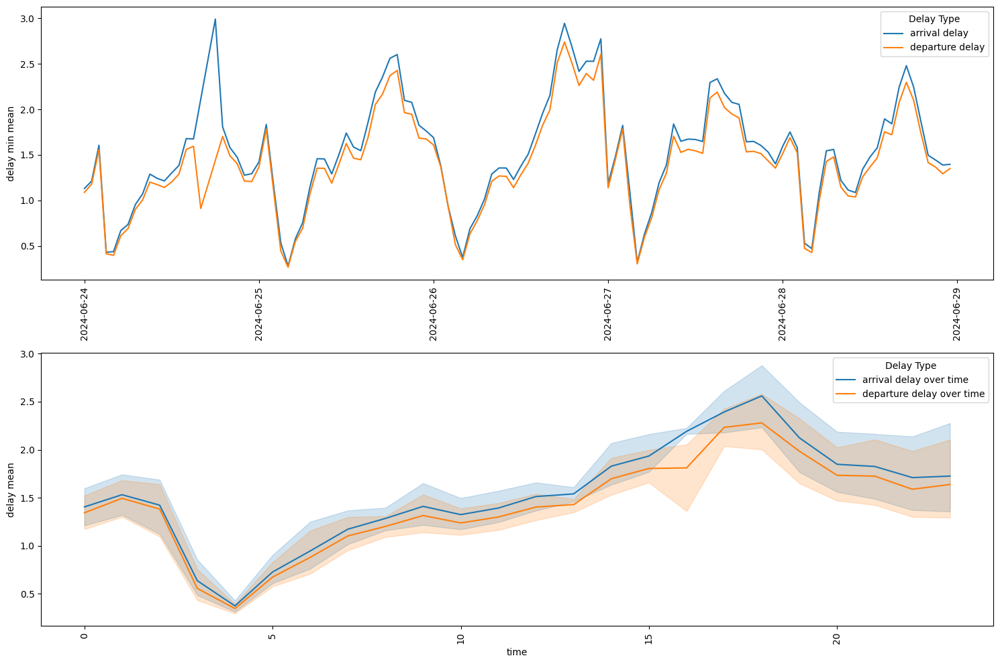

In [23]:
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival and departure delays over datetime
sns.lineplot(df_temp_arr_plt, x="arrival_plan_datetime", y="arrival_delay_m", label="arrival delay", ax=axes[0])
sns.lineplot(df_temp_dep_plt, x="departure_plan_datetime", y="departure_delay_m", label="departure delay", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delay min mean")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Delay Type")

# Second plot: arrival and departure delays over time of day
sns.lineplot(df_temp_arr_plt, x="arrival_plan_hour", y="arrival_delay_m", label="arrival delay over time", ax=axes[1])
sns.lineplot(df_temp_dep_plt, x="departure_plan_hour", y="departure_delay_m", label="departure delay over time", ax=axes[1])
axes[1].set_xlabel("time")
axes[1].set_ylabel("delay mean")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Delay Type")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


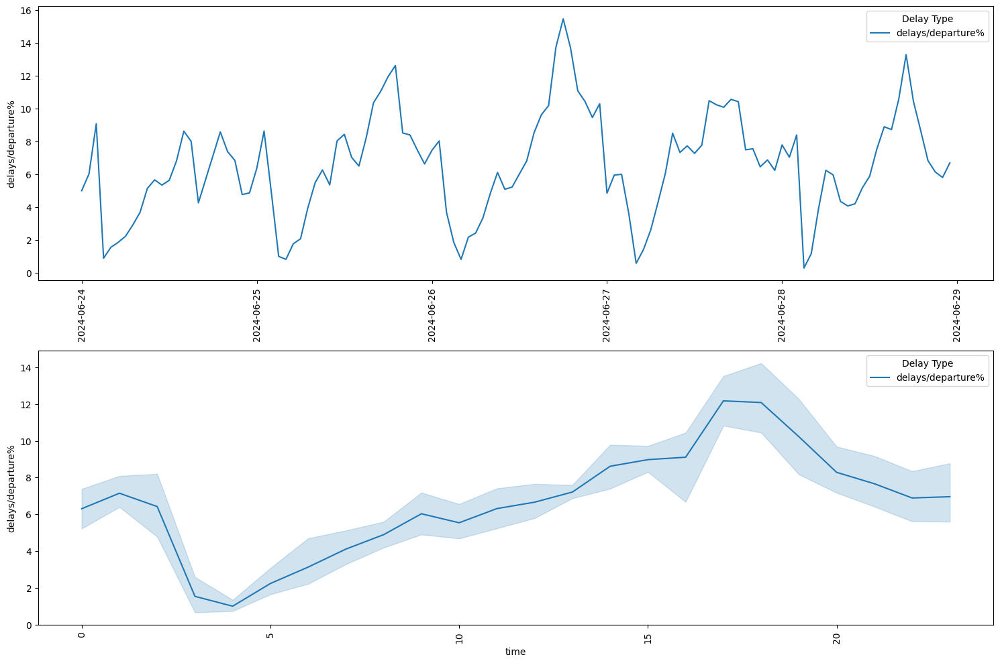

In [24]:
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival and departure delays over datetime
sns.lineplot(df_temp_cnt, x="departure_plan_datetime", y="delay_cnt/departure", label="delays/departure%", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delays/departure%")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Delay Type")

# Second plot: arrival and departure delays over time of day
sns.lineplot(df_temp_cnt, x="departure_plan_hour", y="delay_cnt/departure", label="delays/departure%", ax=axes[1])
axes[1].set_xlabel("time")
axes[1].set_ylabel("delays/departure%")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Delay Type")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


the data indicates a seasonality with peaks around late afternoon around 16:00.<br>
the gap on the 24th comes from a gap in the data collection around that time

as arrival and departure follow a similar temporal pattern, we will only discuss departure going further, as most departure delays also inherit arrival delays, but they can also be the source.

In [26]:
df_temp_cat = df_temp_dep.groupby(["departure_plan_datetime", "category"], as_index=False).departure_delay_m.mean()
df_temp_cat2 = df_temp_dep.groupby(["departure_plan_hour", "category"], as_index=False).departure_delay_m.mean()


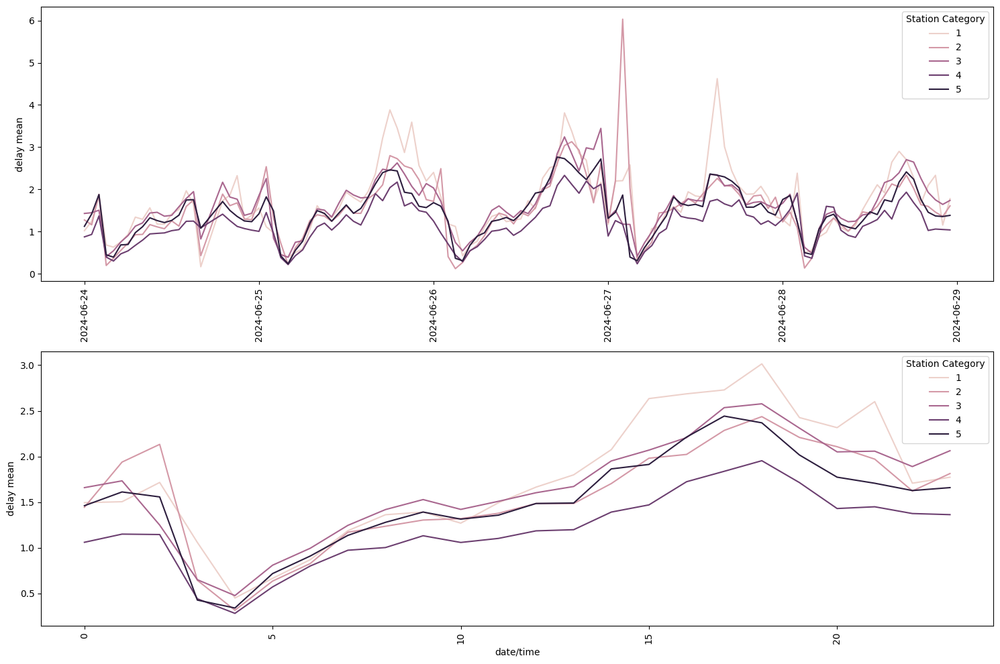

In [27]:
# Create a figure with two subplots arranged vertically
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival delays over datetime with category hue
sns.lineplot(df_temp_cat, x="departure_plan_datetime", y="departure_delay_m", hue="category", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delay mean")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Station Category")

# Second plot: arrival delays over time of day with category hue
sns.lineplot(df_temp_cat2, x="departure_plan_hour", y="departure_delay_m", hue="category", ax=axes[1])
axes[1].set_xlabel("date/time")
axes[1].set_ylabel("delay mean")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Station Category")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


In [28]:
df.state.unique()


array(['Nordrhein-Westfalen', 'Baden-Württemberg', 'Niedersachsen',
       'Schleswig-Holstein', 'Bayern', 'Berlin', 'Hamburg',
       'Rheinland-Pfalz', 'Mecklenburg-Vorpommern', 'Thüringen',
       'Sachsen', 'Sachsen-Anhalt', 'Brandenburg', 'Hessen', 'Saarland',
       'Bremen'], dtype=object)

In [29]:
statelist = df.state.unique()
frames = {}
for state in statelist:
    frames[state] = df[df["state"] == state]



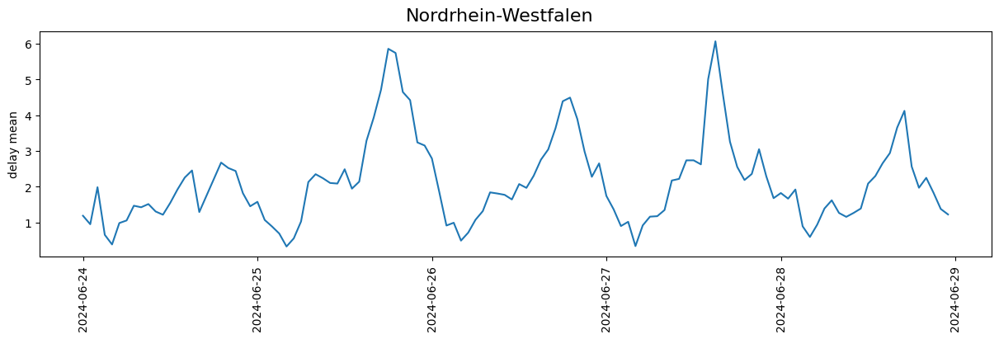

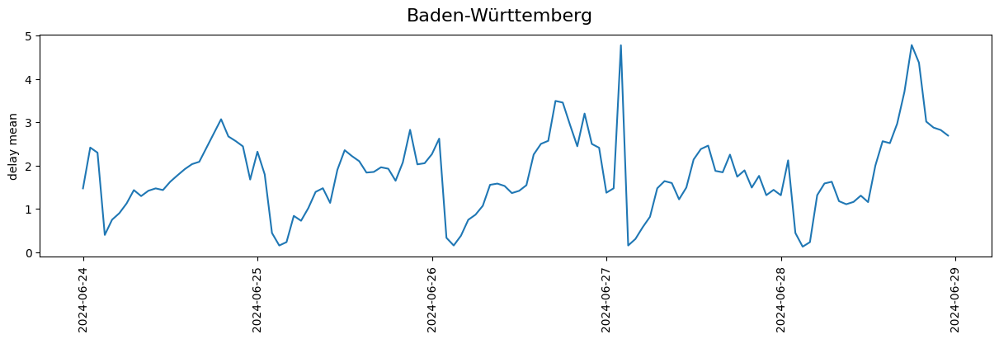

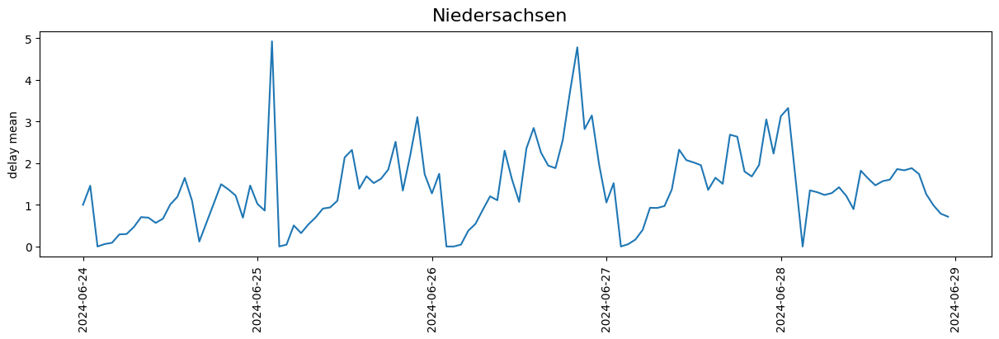

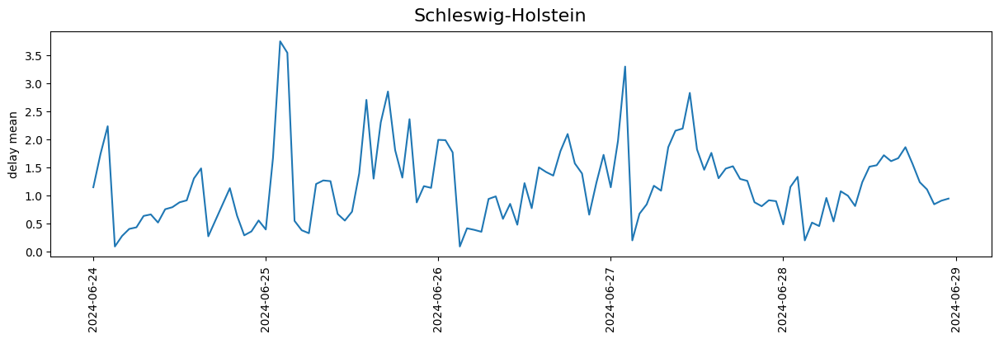

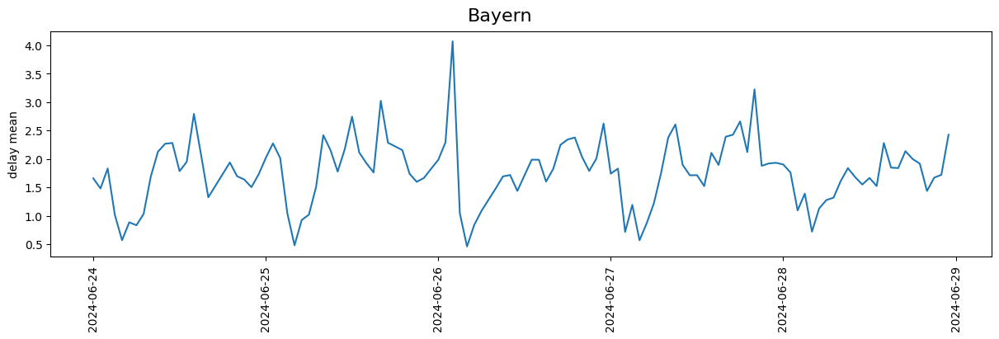

...

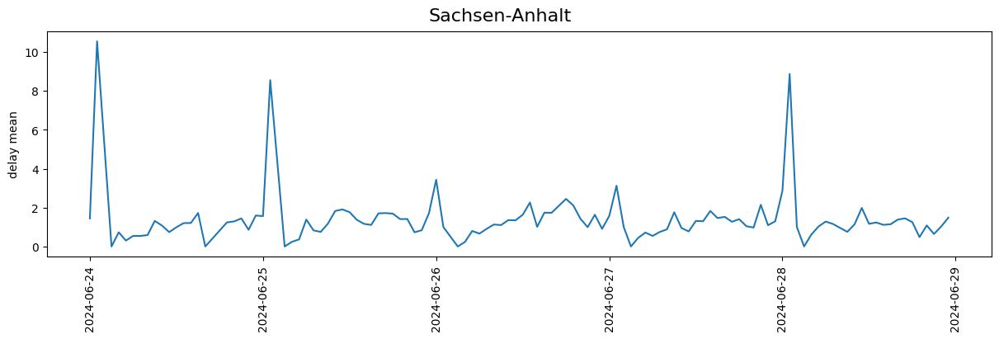

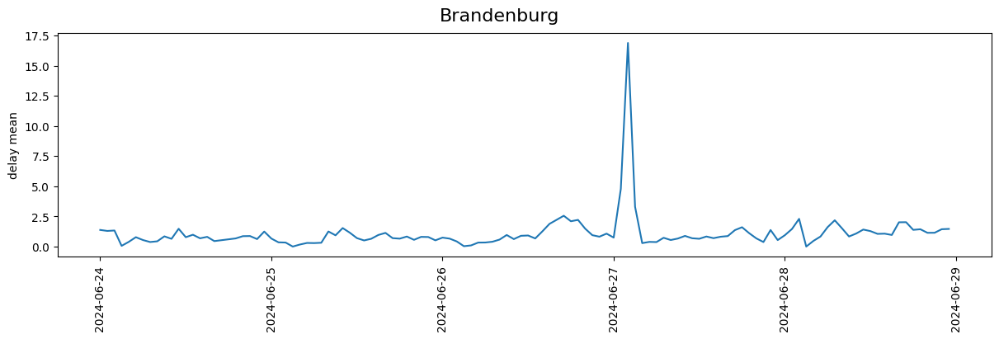

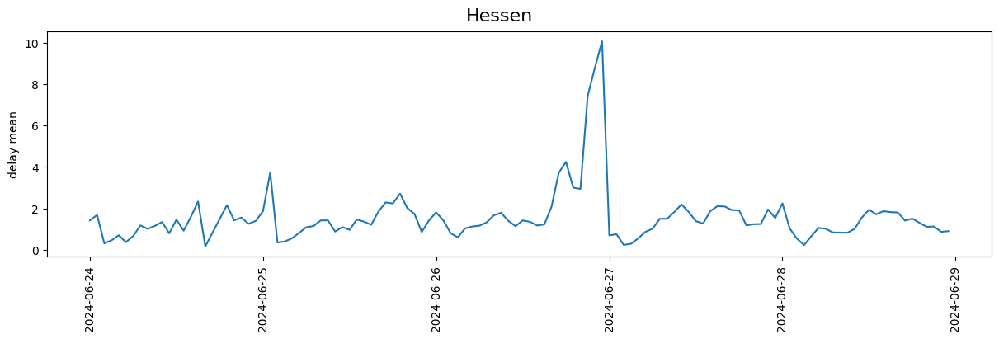

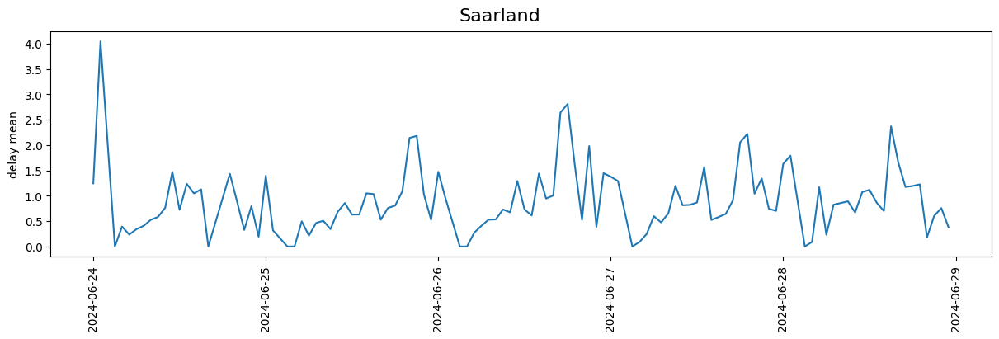

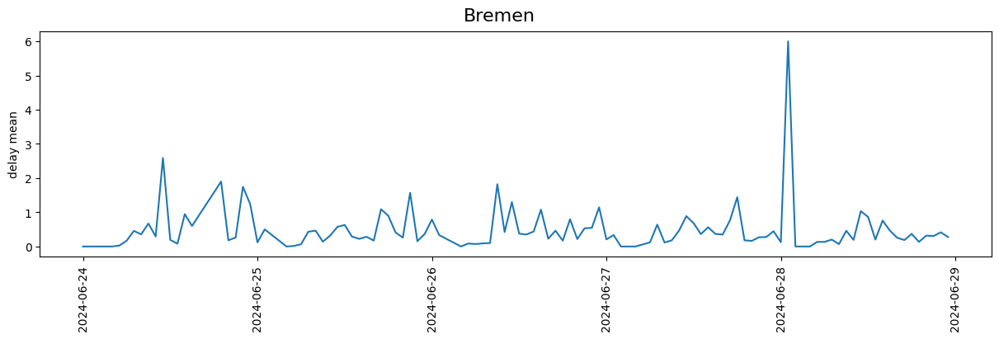

In [30]:
for state in statelist:
    fig, axes = plt.subplots(1, 1, figsize=(12, 4), constrained_layout=True)
    df_temp = frames[state].copy()
    df_temp.set_index('departure_plan', inplace=True)
    numeric_cols = df_temp.select_dtypes(include=['float64', 'int64'])
    hourly_data = numeric_cols.resample('h').mean()

    sns.lineplot(hourly_data, x=hourly_data.index,  y="departure_delay_m", ax=axes)
    axes.set_xlabel("")
    axes.set_ylabel("delay mean")
    axes.tick_params(axis='x', rotation=90)
    #axes.legend(title="Station Category")


    fig.suptitle(state, fontsize=16)
    plt.show()



Some states show more seasonality than others, while there are also several outliers present

In [31]:
heatmap_df2 = df_temp_dep.groupby(["name","departure_plan_datetime"], as_index=False ).mean(numeric_only=True)

In [32]:
fig = px.density_mapbox(
    heatmap_df2,
    lat='lat',
    lon='long',
    z='departure_delay_m',
    hover_name='name',
    radius=10,
    range_color=[0, heatmap_df2.departure_delay_m.max()],
    mapbox_style="carto-positron",
    center={"lat": 51.1657, "lon": 10.4515},
    zoom=5,
    width=600,
    height=700,
    title="Departure Delays over time",
    animation_frame="departure_plan_datetime"
)

fig.update_layout(
    margin={"r": 0, "t": 40, "l": 0, "b": 0},  # Reduced margins
    coloraxis_showscale=False
    )
fig.show()

In [33]:
del heatmap_df2, df_temp_arr, df

In [34]:
df_temp_dep.head()

,line,path,category,name,state,city,long,lat,arrival_plan,departure_plan,...,departure_delay_m,arrival_delay_check,departure_delay_check,info,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date,departure_plan_hour,departure_plan_datetime
140314,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-06-24 00:00:00,2024-06-24 00:01:00,...,0,on_time,on_time,NaN,00:00:00,2024-06-24,00:01:00,2024-06-24,0,2024-06-24 00:00:00
140315,18,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-06-24 00:17:00,...,0,on_time,on_time,NaN,NaT,NaT,00:17:00,2024-06-24,0,2024-06-24 00:00:00
140316,RE18,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-06-24 00:30:00,...,0,on_time,on_time,NaN,NaT,NaT,00:30:00,2024-06-24,0,2024-06-24 00:00:00
140317,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-06-24 00:03:00,2024-06-24 00:04:00,...,4,on_time,on_time,NaN,00:03:00,2024-06-24,00:04:00,2024-06-24,0,2024-06-24 00:00:00
140318,33,Krefeld Hbf|Forsthaus|Anrath|Viersen|Mönchengl...,5,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-06-24 00:24:00,2024-06-24 00:25:00,...,0,on_time,on_time,NaN,00:24:00,2024-06-24,00:25:00,2024-06-24,0,2024-06-24 00:00:00


In [35]:
time_format = "%H:%M:%S"
df_temp_dep["departure_plan_time"] = pd.to_datetime(df_temp_dep["departure_plan_time"], format=time_format)
df_temp_dep["departure_plan_minute"] = df_temp_dep["departure_plan_time"].dt.minute

days = [datetime.date(2024, 6, 25),
       datetime.date(2024, 6, 26), datetime.date(2024, 6, 27),
       datetime.date(2024, 6, 28)]

df_temp_dep2 = df_temp_dep[df_temp_dep["departure_plan_date"].isin(days)]

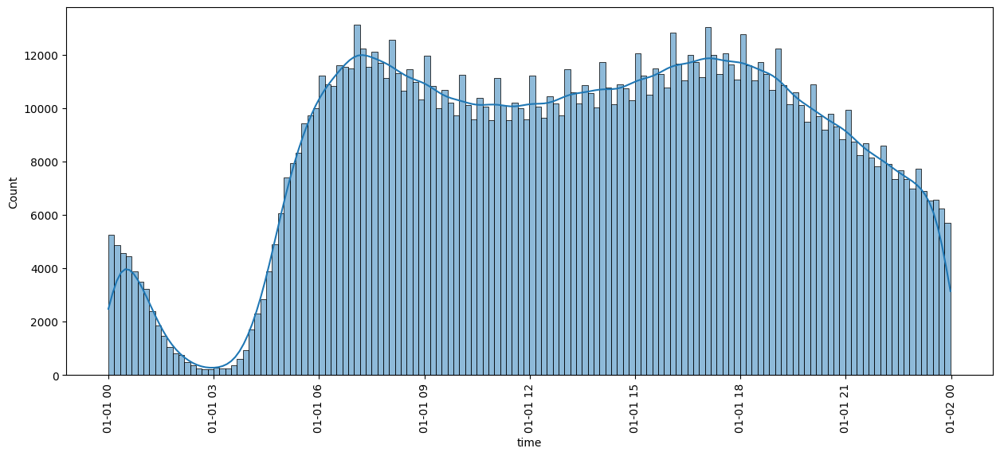

In [47]:
fig, axes = plt.subplots(ncols=1, figsize=(15, 6))
sns.histplot(df_temp_dep2, x="departure_plan_time", ax=axes, bins=6*24, kde=True)
axes.set_xlabel("time")
axes.tick_params(axis='x', rotation=90)

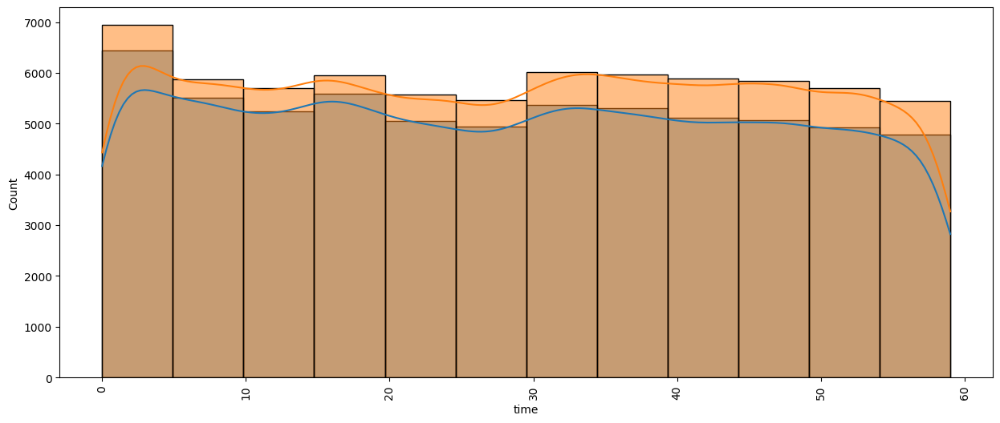

In [48]:
fig, axes = plt.subplots(ncols=1, figsize=(15, 6))
# First plot: arrival and departure delays over datetime
sns.histplot(df_temp_dep2[df_temp_dep2["departure_plan_hour"] == 9], bins=12, x="departure_plan_minute", label="9", ax=axes, alpha=0.5, kde=True)
sns.histplot(df_temp_dep2[df_temp_dep2["departure_plan_hour"] == 16],bins=12, x="departure_plan_minute", label="16", ax=axes, alpha=0.5, kde=True)
axes.set_xlabel("time")
axes.tick_params(axis='x', rotation=90)
#axes[0].get_legend().remove()

In [44]:
df_temp_dep2.head()

,line,path,category,name,state,city,long,lat,arrival_plan,departure_plan,...,arrival_delay_check,departure_delay_check,info,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date,departure_plan_hour,departure_plan_datetime,departure_plan_minute
389033,RB75,Aschaffenburg Hbf|Mainaschaff|Stockstadt(Main),5,Babenhausen (Hess),Hessen,Babenhausen,8.957182,49.957963,2024-06-24 23:58:00,2024-06-25 00:00:00,...,on_time,on_time,NaN,23:58:00,2024-06-24,1900-01-01 00:00:00,2024-06-25,0,2024-06-25 00:00:00,0
389034,RE85,Frankfurt(Main)Hbf|Frankfurt(Main)Süd|Offenbac...,5,Babenhausen (Hess),Hessen,Babenhausen,8.957182,49.957963,2024-06-24 23:56:00,2024-06-25 00:01:00,...,on_time,on_time,NaN,23:56:00,2024-06-24,1900-01-01 00:01:00,2024-06-25,0,2024-06-25 00:00:00,1
389036,RB75,Wiesbaden Hbf|Mainz Hbf|Mainz Römisches Theate...,5,Babenhausen (Hess),Hessen,Babenhausen,8.957182,49.957963,2024-06-24 23:58:00,2024-06-25 00:00:00,...,on_time,on_time,NaN,23:58:00,2024-06-24,1900-01-01 00:00:00,2024-06-25,0,2024-06-25 00:00:00,0
389084,1,Rostock Hbf|Schwaan|Bützow|Blankenberg(Meckl)|...,4,Bad Kleinen,Mecklenburg-Vorpommern,Bad Kleinen,11.466925,53.766974,2024-06-24 23:59:00,2024-06-25 00:00:00,...,on_time,on_time,NaN,23:59:00,2024-06-24,1900-01-01 00:00:00,2024-06-25,0,2024-06-25 00:00:00,0
389101,6,Leipzig Hbf|Leipzig-Liebertwolkwitz,5,Bad Lausick,Sachsen,Bad Lausick,12.648695,51.143803,2024-06-24 23:59:00,2024-06-25 00:00:00,...,on_time,on_time,NaN,23:59:00,2024-06-24,1900-01-01 00:00:00,2024-06-25,0,2024-06-25 00:00:00,0


In [45]:
df_temp_dep2[df_temp_dep2["name"].isin(worst)].describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,departure_plan_time,departure_plan_hour,departure_plan_minute
count,246830.000000,246830.000000,246830.000000,228917,246830,212772,225900,246830.000000,246830.000000,246830,246830.00000,246830.000000
mean,3.776506,8.272858,50.396708,2024-06-27 01:33:56.870480640,2024-06-27 01:31:02.991856896,2024-06-30 13:55:12.348710656,2024-06-30 13:56:49.451261440,2.996329,3.106118,1900-01-01 13:30:06.285621504,13.02415,28.655747
min,1.000000,6.073840,47.456591,2024-06-24 23:37:00,2024-06-25 00:00:00,2024-06-24 23:37:00,2024-06-25 00:00:00,0.000000,0.000000,1900-01-01 00:00:00,0.00000,0.000000
25%,3.000000,7.072023,49.341268,2024-06-26 00:04:00,2024-06-26 00:02:00,2024-06-26 00:17:45,2024-06-26 00:18:00,0.000000,0.000000,1900-01-01 08:48:00,8.00000,13.000000
50%,4.000000,8.256293,50.782871,2024-06-27 00:04:00,2024-06-26 23:58:00,2024-07-04 00:17:00,2024-07-04 00:21:00,0.000000,1.000000,1900-01-01 13:39:00,13.00000,29.000000
75%,5.000000,9.156959,51.254363,2024-06-28 00:04:00,2024-06-28 00:02:00,2024-07-04 23:53:00,2024-07-04 23:52:00,3.000000,3.000000,1900-01-01 18:15:00,18.00000,44.000000
max,5.000000,13.190867,54.888814,2024-06-28 23:59:00,2024-06-28 23:59:00,2024-07-06 00:34:00,2024-07-06 00:35:00,210.000000,210.000000,1900-01-01 23:59:00,23.00000,59.000000
std,1.145653,1.407449,1.318288,NaN,NaN,NaN,NaN,6.561524,6.559628,NaN,5.77903,17.536291


In [46]:
df_temp_dep2[df_temp_dep2["name"].isin(best)].describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,departure_plan_time,departure_plan_hour,departure_plan_minute
count,394941.000000,394941.000000,394941.000000,355106,394941,270566,294351,394941.000000,394941.000000,394941,394941.000000,394941.000000
mean,4.057948,11.683339,52.069954,2024-06-27 01:27:24.218233600,2024-06-27 01:27:01.961457664,2024-06-30 14:23:15.219206912,2024-06-30 14:43:26.667958016,0.490468,0.513821,1900-01-01 13:34:43.668902144,13.092044,29.205167
min,1.000000,6.557283,47.411032,2024-06-24 23:55:00,2024-06-25 00:00:00,2024-06-24 23:55:00,2024-06-25 00:00:00,0.000000,0.000000,1900-01-01 00:00:00,0.000000,0.000000
25%,4.000000,9.993883,51.380687,2024-06-25 23:50:00,2024-06-25 23:51:00,2024-06-26 00:19:00,2024-06-26 00:27:00,0.000000,0.000000,1900-01-01 08:47:00,8.000000,14.000000
50%,4.000000,12.375394,52.500737,2024-06-26 23:36:00,2024-06-26 23:38:00,2024-07-04 00:33:00,2024-07-04 00:57:00,0.000000,0.000000,1900-01-01 13:52:00,13.000000,29.000000
75%,5.000000,13.388464,53.160288,2024-06-27 23:44:00,2024-06-27 23:46:00,2024-07-05 00:24:00,2024-07-05 00:32:00,0.000000,0.000000,1900-01-01 18:20:00,18.000000,44.000000
max,5.000000,14.979080,54.774039,2024-06-28 23:59:00,2024-06-28 23:59:00,2024-07-06 00:06:00,2024-07-06 00:07:00,99.000000,111.000000,1900-01-01 23:59:00,23.000000,59.000000
std,0.807830,1.940066,1.562930,NaN,NaN,NaN,NaN,1.885301,1.916490,NaN,5.779152,17.471459


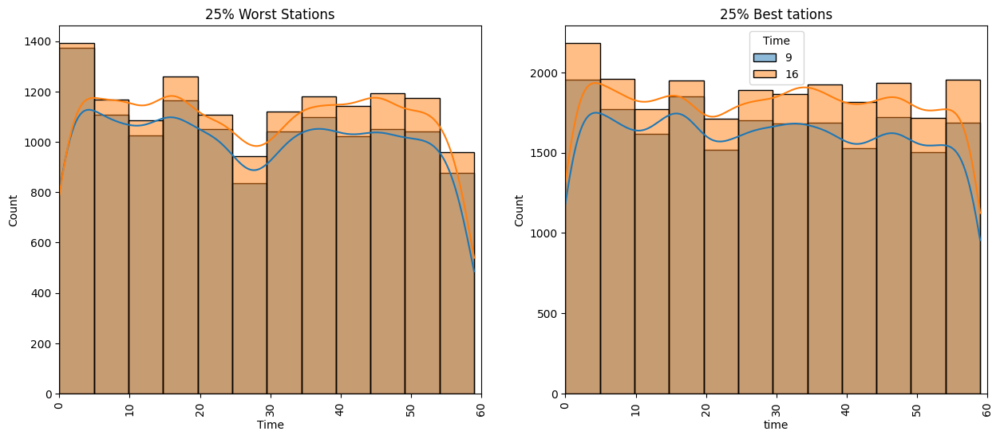

In [41]:
fig, axes = plt.subplots(ncols=2, figsize=(15, 6))



sns.histplot(df_temp_dep2[(df_temp_dep2["departure_plan_hour"] == 9)&(df_temp_dep2["name"].isin(worst))], kde=True, bins=12, label="9", x="departure_plan_minute", ax=axes[0], alpha=0.5)
sns.histplot(df_temp_dep2[(df_temp_dep2["departure_plan_hour"] == 16)&(df_temp_dep2["name"].isin(worst))], kde=True, bins=12, label="16", x="departure_plan_minute", ax=axes[0], alpha=0.5)
axes[0].set_xlabel("Time")
axes[0].tick_params(axis='x', rotation=90)
axes[0].set_title("25% Worst Stations")
axes[0].set_xlim([0,60])
#axe[0].get_legend().remove()


sns.histplot(df_temp_dep2[(df_temp_dep2["departure_plan_hour"] == 9)&(df_temp_dep2["name"].isin(best))], kde=True,bins=12, label="9", x="departure_plan_minute", ax=axes[1], alpha=0.5)
sns.histplot(df_temp_dep2[(df_temp_dep2["departure_plan_hour"] == 16)&(df_temp_dep2["name"].isin(best))], kde=True,bins=12, label="16", x="departure_plan_minute", ax=axes[1], alpha=0.5)
axes[1].set_xlabel("time")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Time")
axes[1].set_title("25% Best tations")
axes[1].set_xlim([0,60])

plt.show()


In [43]:
def calculate_histogram_bin_counts(data, bins, range):
    counts, _ = np.histogram(data, bins=bins, range=range)
    return counts

bins = 12
range = (0, 60)
data_worst = df_temp_dep2[(df_temp_dep2["departure_plan_hour"] == 16) & (df_temp_dep2["name"].isin(worst))]["departure_plan_minute"]
data_best = df_temp_dep2[(df_temp_dep2["departure_plan_hour"] == 16) & (df_temp_dep2["name"].isin(best))]["departure_plan_minute"]

bin_counts_worst = calculate_histogram_bin_counts(data_worst, bins, range)
bin_counts_best = calculate_histogram_bin_counts(data_best, bins, range)

def gini_coefficient(bin_counts):
    sorted_counts = np.sort(bin_counts)
    n = len(bin_counts)
    index = np.arange(1, n + 1)
    return (2 * np.sum(index * sorted_counts) / (n * np.sum(sorted_counts))) - (n + 1) / n


gini_worst = gini_coefficient(bin_counts_worst)
gini_best = gini_coefficient(bin_counts_best)

print(f"Gini Coefficients \n Worst: {gini_worst.round(3)},\n Best: {gini_best.round(3)}")

Gini Coefficients 
 Worst: 0.054,
 Best: 0.035


The departure times are more evenly distributed at the 25% of best stations than the 25% of worst stations
